In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

/Users/mitchellkrieger/opt/anaconda3/envs/learn-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/Users/mitchellkrieger/opt/anaconda3/envs/learn-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/Users/mitchellkrieger/opt/anaconda3/envs/learn-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/Users/mitchellkrieger/opt/anaconda3/envs/learn-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


In [5]:
target = pd.read_csv('./0bf8bc6e-30d0-4c50-956a-603fc693d966.csv')
features = pd.read_csv('./4910797b-ee55-40a7-8668-10efd5c1b960.csv')

In [9]:
df = features.merge(target, on='id')

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

<BarContainer object of 3 artists>

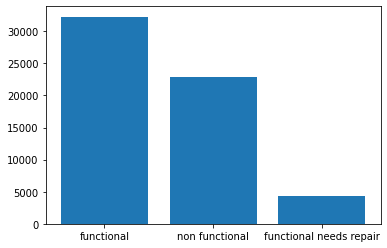

In [15]:
plt.bar(df.status_group.value_counts().index,df.status_group.value_counts().values)

In [59]:
top_funders = list(df.funder.value_counts().head(50).index)
df.funder.value_counts().head(50)

Government Of Tanzania            9084
Danida                            3114
Hesawa                            2202
Rwssp                             1374
World Bank                        1349
Kkkt                              1287
World Vision                      1246
Unicef                            1057
Tasaf                              877
District Council                   843
Dhv                                829
Private Individual                 826
Dwsp                               811
0                                  777
Norad                              765
Germany Republi                    610
Tcrs                               602
Ministry Of Water                  590
Water                              583
Dwe                                484
Netherlands                        470
Hifab                              450
Adb                                448
Lga                                442
Amref                              425
Fini Water               

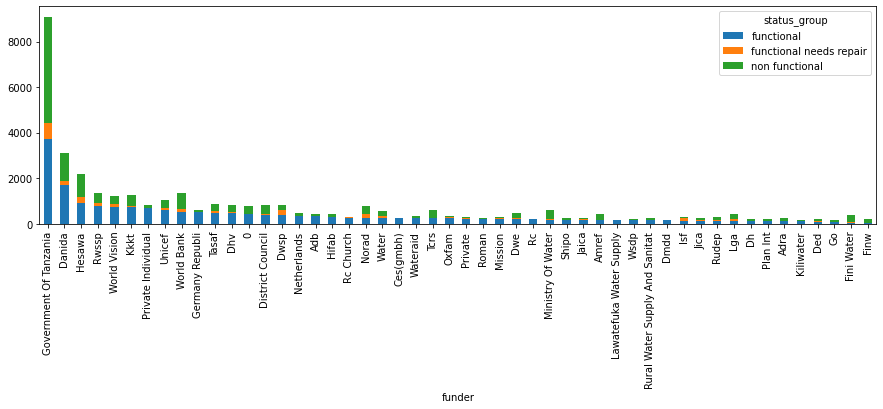

In [64]:
df.loc[df['funder'].isin(top_funders)].groupby('funder').status_group.value_counts().unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

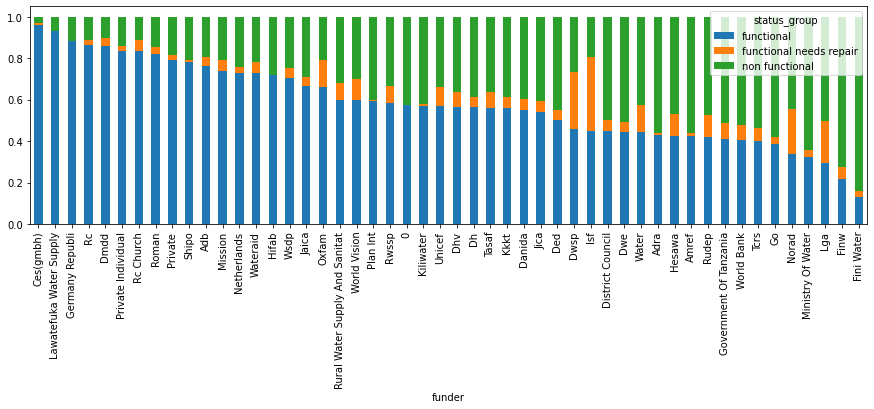

In [65]:
df.loc[df['funder'].isin(top_funders)].groupby('funder').status_group.value_counts(normalize=True).unstack()\
    .sort_values('functional',ascending=False).plot.bar(stacked=True)
fig = plt.gcf()
fig.set_figwidth(15)

In [66]:
df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


In [67]:
df.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [78]:
conditions = [
    df.construction_year == 0,
    (df.construction_year >= 1960) & (df.construction_year <1980),
    (df.construction_year >= 1980) & (df.construction_year <2000),
    df.construction_year >= 2000
]

choices = [0,1,2,3]

df['bin_year'] = np.select(conditions,choices)

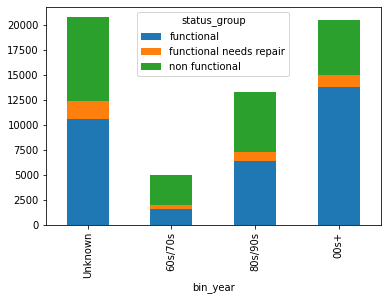

In [87]:
df.groupby('bin_year').status_group.value_counts().unstack().plot.bar(stacked=True)
ax = plt.gca()
ax.set_xticklabels(['Unknown','60s/70s','80s/90s','00s+']);

In [91]:
import geopandas as gpd
import folium

In [100]:
m = folium.Map(location=[-6.3690,34.8888], zoom_start=7)

df['coords'] = list(zip(df.latitude,df.longitude))

conditions = [df.status_group == 'functional',
              df.status_group == 'functional needs repair',
              df.status_group == 'non functional']

choices = ['blue','orange','green']

colors = np.select(conditions,choices)

for i, point in enumerate(df.coords):
    folium.CircleMarker(point,radius=.001,color=colors[i]).add_to(m)

m

In [96]:
a = ['this','is','a','test']

In [97]:
for i, text in enumerate(a):
    print('i: ',i)
    print('text: ',text)

i:  0
text:  this
i:  1
text:  is
i:  2
text:  a
i:  3
text:  test
